In [1]:
import sys
from pathlib import Path

import parc
import matplotlib.pyplot as plt
import matplotlib.pylab as pl
import matplotlib
from matplotlib.colors import ListedColormap
import numpy as np
import pandas as pd
import umap
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import LogNorm
from skimage import measure
from sklearn.decomposition import PCA
import seaborn as sns
import scipy.cluster.hierarchy as sch
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from collections import defaultdict


In [2]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
# Import path for config
module_path = str(Path.cwd().parents[0])
if module_path not in sys.path:
    sys.path.append(module_path)

# Import path for src
module_path = str(Path.cwd().parents[0] / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

In [4]:
from config import *
import my_io as io

In [5]:
np.random.seed(0)
tol=0.4

# Import metadata information

In [6]:
df_metadata = pd.read_csv(data_dir / 'metadata.csv')
df_metadata.head()

,Pos,Grades,Stage,Directory
0,B1,2,I,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI001_B1
1,B3,2,I,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI005_B3
2,B5,2,II,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI006_B5
3,C6,AT,AT,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI007_C6
4,D7,3,IIIA,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI008_D7


In [7]:
datasets = df_metadata.Directory.to_list()
datasets = [name.split('\\')[-1] for name in datasets]

In [8]:
print(datasets)

['ROI001_B1', 'ROI005_B3', 'ROI006_B5', 'ROI007_C6', 'ROI008_D7', 'ROI009_D9', 'ROI012_E1', 'ROI015_B6', 'ROI016_F3', 'ROI017_F2', 'ROI018_G1', 'ROI019_G5', 'ROI020_E5', 'ROI021_E7']


In [9]:
# Define which dataset to work on 
dataset = datasets[4]
path_cluster = io.create_folder(dataset, data_cluster)

Folder is already there


# Read marker images and cell mask

In [10]:
imgs, markers = io.read_img(dataset, data_ROI)
marker2img = dict(zip(markers, imgs))
print(f'Image stack shape of {imgs.shape}')

Image stack shape of (22, 800, 800)


In [11]:
mask = io.read_cell_mask(dataset, data_ROI)
print(f'Mask shape of {mask.shape}')
print(f'Number of cell is {mask.max()}')

Mask shape of (800, 800)
Number of cell is 3815


In [12]:
def get_cell_expression_level(marker2img_dict, mask):
    # Get each cell region 
    morph_prop = pd.DataFrame(measure.regionprops_table(mask, properties=['label', 'area'])).set_index('label')
    
    # Multiple each cell region by mean intensity 
    df_list = []
    for marker, img in marker2img_dict.items():
        if marker not in ['DNA1', 'DNA2']:
            exp_prop = pd.DataFrame(measure.regionprops_table(mask, img, properties=['label','mean_intensity'])).set_index('label')
            df = pd.DataFrame(morph_prop.values * exp_prop.values, index=morph_prop.index, columns=[marker])
#             df = exp_prop.rename(columns = {'mean_intensity': marker}, errors = 'raise')
            df_list.append(df)
    df_exp = pd.concat(df_list, axis=1)
    return df_exp 

df_exp = get_cell_expression_level(marker2img, mask)

In [13]:
# Z score normalization by marker
x_scaled = StandardScaler().fit_transform(np.log(df_exp+1))
df_exp = pd.DataFrame(x_scaled, index = df_exp.index, columns=df_exp.columns)
df_exp.head()

# Per cell
x_scaled = StandardScaler().fit_transform(df_exp.T).T
df_exp = pd.DataFrame(x_scaled, index = df_exp.index, columns=df_exp.columns)
df_exp.head()

,SMA,Vimentin,PanKeratin,H3K9me3,PDL1,CD44,FoxP3,CD4,ECadherin,CD68,CD20,CD8a,PD1,GranzymeB,Ki67,Col1,CD3,Histone3,CD45RO,MHCII
label,,,,,,,,,,,,,,,,,,,,
1,1.521522,0.329789,-1.738223,-0.813746,-0.333085,-0.108453,-0.002104,1.824814,-0.906844,0.269220,-2.001181,0.044333,0.651820,-0.875538,0.593138,1.393915,1.164643,-0.554267,0.146206,-0.605959
2,-0.426454,-0.418063,2.198751,0.481635,0.275404,-1.474064,-0.018047,-1.168689,2.048994,-0.950655,-0.423714,0.653330,-0.010230,0.276156,-0.176008,-1.028827,-1.034444,0.017370,-0.489179,1.666736
3,1.363982,0.684495,-0.889689,-1.384095,-0.702457,-0.487534,-1.626905,1.626267,-0.382233,0.039446,0.668897,0.376059,0.603158,-0.506584,-0.902394,2.106135,0.334316,-1.121649,0.787410,-0.586626
4,-1.525430,-0.849503,2.606701,-0.223269,-0.611857,-1.608892,-0.149719,0.395668,1.579416,0.500028,0.297692,-0.035581,-1.209680,1.469450,-0.324692,-0.063840,-0.178524,-0.421739,0.427789,-0.074017
5,-0.643329,0.410263,1.488055,0.640809,1.059855,-0.626435,-0.141940,-1.207454,1.626593,-1.017304,0.643014,-0.702559,1.426222,-0.376813,-1.443150,-0.647427,-0.825457,0.367795,-1.378496,1.347758


# cell level clustering 

In [14]:
X = df_exp.values
parc1 = parc.PARC(X, jac_weighted_edges = False)
parc1.run_PARC() 
parc_labels = parc1.labels

graph = parc1.knngraph_full()
embedding = parc1.run_umap_hnsw(X, graph, random_state = 1)

input data has shape 3815 (samples) x 20 (features)
knn struct was not available, so making one
commencing local pruning based on Euclidean distance metric at 3 s.dev above mean
commencing global pruning
commencing community detection
partition type MVP
list of cluster labels and populations 14 [(0, 617), (1, 548), (2, 487), (3, 473), (4, 336), (5, 294), (6, 283), (7, 183), (8, 151), (9, 142), (10, 117), (11, 81), (12, 80), (13, 23)]
time elapsed 3.5 seconds
a,b, spread, dist 1.5769434603935901 0.8950608781603765 1.0 0.1
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs


In [15]:
df_exp['Cluster'] = parc_labels
df_per_label = df_exp.groupby('Cluster').mean()

# my_cmap = 'viridis'
# scale_name = 'Relative Intensity' 

my_cmap_name = 'bwr'
scale_name = 'Z-score'

log_norm = LogNorm(vmin=np.min(df_per_label.values), vmax=np.max(df_per_label.values))

## Plotting

In [41]:
# def create_HM(df_per_label, path, my_cmap, row_colors, scale_name, cellSizePixels=20, **kwargs):
#     # Calulate the figure size, this gets us close, but not quite to the right place
#     dpi = matplotlib.rcParams['figure.dpi']
#     marginWidth = matplotlib.rcParams['figure.subplot.right']-matplotlib.rcParams['figure.subplot.left']
#     marginHeight = matplotlib.rcParams['figure.subplot.top']-matplotlib.rcParams['figure.subplot.bottom']
#     Ny,Nx = df_per_label.shape
#     figWidth = (Nx*cellSizePixels/dpi)/marginWidth
#     figHeigh = (Ny*cellSizePixels/dpi)/marginHeight
    
#     ax = sns.clustermap(df_per_label,
#                         cmap=my_cmap,
#                         linewidth=0.5,
#                         col_cluster=False,
#                         row_colors=[row_colors],
#                         dendrogram_ratio=(.1, 0.0),
#                         figsize=(figWidth, figHeigh),
#                         **kwargs
#                         )
#     ax.ax_heatmap.set_yticklabels(
#         ax.ax_heatmap.get_yticklabels(), rotation=0)
#     ax.ax_heatmap.set_xticklabels(
#         ax.ax_heatmap.get_xticklabels(), rotation=45, horizontalalignment='right')
#     ax.ax_heatmap.set_xlabel('Marker')
#     ax.ax_heatmap.set_ylabel('Cluster')
    
#     # calculate the size of the heatmap axes
#     axWidth = (Nx*cellSizePixels)/(figWidth*dpi)
#     axHeight = (Ny*cellSizePixels)/(figHeigh*dpi)

#     # resize heatmap
#     ax_heatmap_orig_pos = ax.ax_heatmap.get_position()
#     ax.ax_heatmap.set_position([ax_heatmap_orig_pos.x0, ax_heatmap_orig_pos.y0, 
#                                   axWidth, axHeight])

#     # resize dendrograms to match
#     ax_row_orig_pos = ax.ax_row_dendrogram.get_position()
#     ax.ax_row_dendrogram.set_position([ax_row_orig_pos.x0, ax_row_orig_pos.y0, 
#                                          ax_row_orig_pos.width, axHeight])
#     ax_row_orig_pos = ax.ax_row_colors.get_position()
#     ax.ax_row_colors.set_position([ax_row_orig_pos.x0, ax_row_orig_pos.y0, 
#                                          ax_row_orig_pos.width, axHeight])

#     pos = ax.ax_heatmap.get_position()
#     cbar_mid = (pos.y1 - pos.y0)/2
#     cbar_size=0.2
#     ax.ax_cbar.set_position((1.02, cbar_mid + cbar_size/2, .03, cbar_size))
    
#     # Change colorbar label position
#     cbar = ax.ax_heatmap.collections[0].colorbar
#     cbar.set_label(scale_name, fontsize=12)

#     for _, spine in ax.ax_heatmap.spines.items():
#         spine.set_visible(True)
#         spine.set_linewidth(3)

#     ax.savefig(path, bbox_inches='tight')

def create_HM(df_per_label, path, my_cmap, row_colors, scale_name, cellSizePixels=20, **kwargs):
    # Calulate the figure size, this gets us close, but not quite to the right place
    dpi = matplotlib.rcParams['figure.dpi']
    marginWidth = matplotlib.rcParams['figure.subplot.right']-matplotlib.rcParams['figure.subplot.left']
    marginHeight = matplotlib.rcParams['figure.subplot.top']-matplotlib.rcParams['figure.subplot.bottom']
    Ny,Nx = df_per_label.shape
    figWidth = (Nx*cellSizePixels/dpi)/marginWidth
    figHeigh = (Ny*cellSizePixels/dpi)/marginHeight
    
    ax = sns.clustermap(df_per_label,
                        cmap=my_cmap,
                        linewidth=0.5,
                        row_cluster=False,
                        col_colors=[row_colors],
                        dendrogram_ratio=(0, 0.1),
                        figsize=(figWidth, figHeigh),
                        **kwargs
                        )
    ax.ax_heatmap.set_yticklabels(
        ax.ax_heatmap.get_yticklabels(), rotation=0)
    ax.ax_heatmap.set_xticklabels(
        ax.ax_heatmap.get_xticklabels(), rotation=0)
    ax.ax_heatmap.set_ylabel('Marker')
    ax.ax_heatmap.set_xlabel('Cluster')
    
    # calculate the size of the heatmap axes
    axWidth = (Nx*cellSizePixels)/(figWidth*dpi)
    axHeight = (Ny*cellSizePixels)/(figHeigh*dpi)

    # resize heatmap
    ax_heatmap_orig_pos = ax.ax_heatmap.get_position()
    ax.ax_heatmap.set_position([ax_heatmap_orig_pos.x0, ax_heatmap_orig_pos.y0, 
                                  axWidth, axHeight])

    # resize dendrograms to match
    ax_row_orig_pos = ax.ax_row_dendrogram.get_position()
    ax.ax_row_dendrogram.set_position(
        [ax_row_orig_pos.x0, ax_row_orig_pos.y0, ax_row_orig_pos.width, axHeight]
    )
    ax_col_orig_pos = ax.ax_col_dendrogram.get_position()
    ax.ax_col_dendrogram.set_position([ax_col_orig_pos.x0, ax_heatmap_orig_pos.y0+axHeight,
                                         axWidth, ax_col_orig_pos.height])
    ax_col_orig_pos = ax.ax_col_colors.get_position()
    ax.ax_col_colors.set_position(
        [ax_col_orig_pos.x0, ax_heatmap_orig_pos.y0+axHeight, axWidth, ax_col_orig_pos.height]
    )
    

    pos = ax.ax_heatmap.get_position()
    cbar_size=0.2
    ax.ax_cbar.set_position((1.3, pos.y0, .03, cbar_size))
    
    # Change colorbar label position
    cbar = ax.ax_heatmap.collections[0].colorbar
    cbar.set_label(scale_name, fontsize=12)

    for _, spine in ax.ax_heatmap.spines.items():
        spine.set_visible(True)
        spine.set_linewidth(3)
        
def create_umap(embeddings, labels, path, cmap, name = 'Umap'):
    fig, ax = plt.subplots(figsize=(10, 10))
    X, Y = embeddings[:, 0], embeddings[:, 1]
    ax.scatter(X, Y, c=labels, s=2, cmap=matplotlib.colors.ListedColormap(cmap))
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.tick_params(axis='both', which='both', bottom=False, left=False, labelbottom=False, labelleft=False)

    # Add arrow with spine
    pos = ax.get_position()
    ax.plot(pos.x1, pos.y0, ">k", transform=fig.transFigure, clip_on=False)
    ax.plot(pos.x0, pos.y1, "^k", transform=fig.transFigure, clip_on=False)

    # Add label
    ax.set_xlabel(f'{name} 1')
    ax.set_ylabel(f'{name} 2')
#     fig.savefig(path, bbox_inches='tight')

def create_clustered_cell(mask, cell2label, path, cmap):
    img = np.zeros((mask.shape), dtype=np.uint8)

    for i in cell_id:
        img = np.where(mask==i, cell2label[i], img)
    
    bg_color = np.array([[0, 0, 0, 0]])
    my_cmap = np.concatenate((bg_color, cmap))
    my_cmap = ListedColormap(my_cmap)
    
    # Show clustered cell
    fig, ax = plt.subplots(figsize=(10.,10))
    ax.imshow(marker2img['DNA1'], cmap='gray', alpha=0.8)
    ax.imshow(img, cmap=my_cmap, alpha = 0.8, interpolation='None')
    ax.axis('off')
    fig.savefig(path, bbox_inches='tight')



In [42]:
# import seaborn as sns;
# iris = sns.load_dataset("iris")
# species = iris.pop("species")
# g = sns.clustermap(iris)
# dir(g.ax_heatmap.get_position)

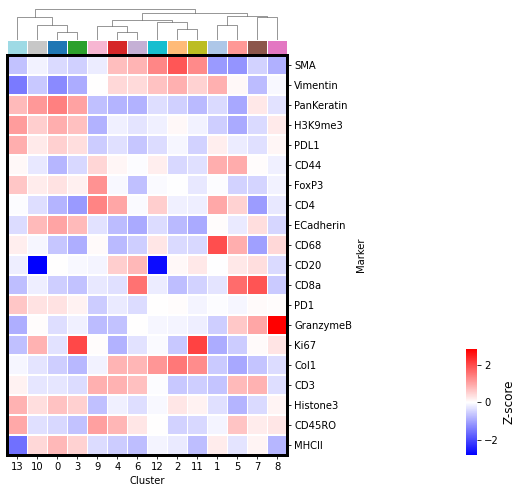

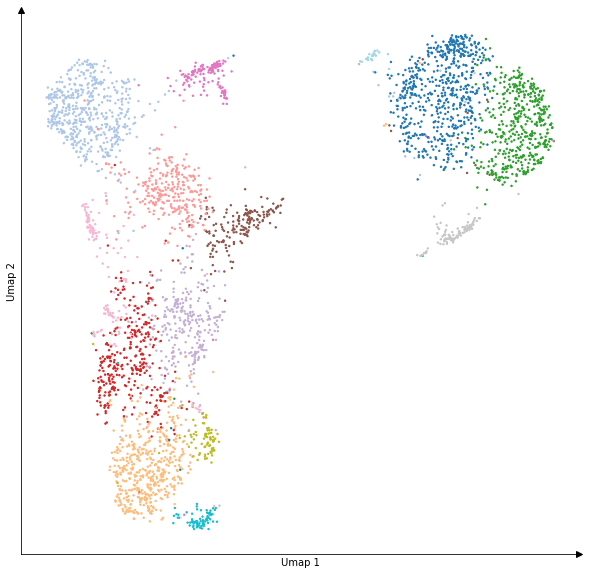

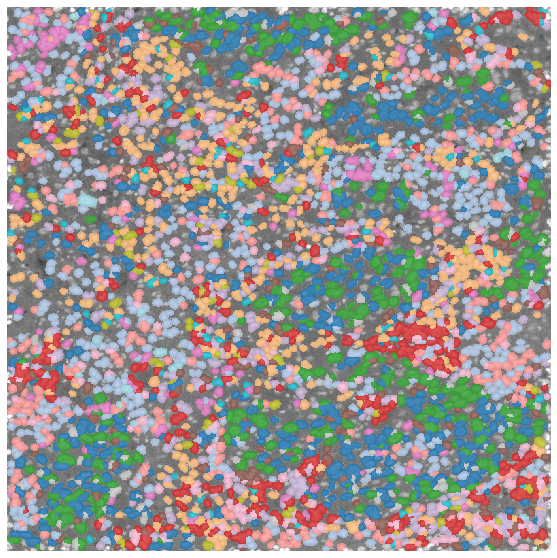

In [43]:
d = sch.distance.pdist(df_per_label, metric='cosine')
L = sch.linkage(d, method="average")

# Get random colormap
vals = np.linspace(0, 1, len(df_per_label))
my_cmap_row = plt.cm.tab20(vals)

# Change to row colors for clustermap
labels = df_per_label.index.to_list()
my_cmap_dict = dict(zip(labels, my_cmap_row))
row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)

create_HM(df_per_label.T, path_cluster / 'parc_HM.png', my_cmap_name, row_colors, scale_name, row_linkage=L)

cell_id = df_exp.index.to_list()
cell2label = dict(zip(cell_id, np.array(parc_labels)+1))

create_umap(embedding, parc_labels, path_cluster / 'parc_cell_mask_umap.png', my_cmap_row)
create_clustered_cell(mask, cell2label, path_cluster / 'parc_cell_mask_cluster.png' , my_cmap_row)

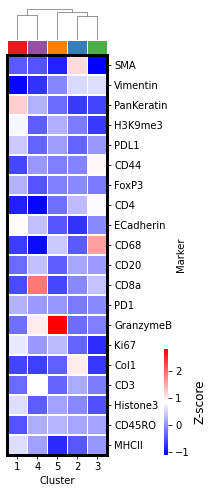

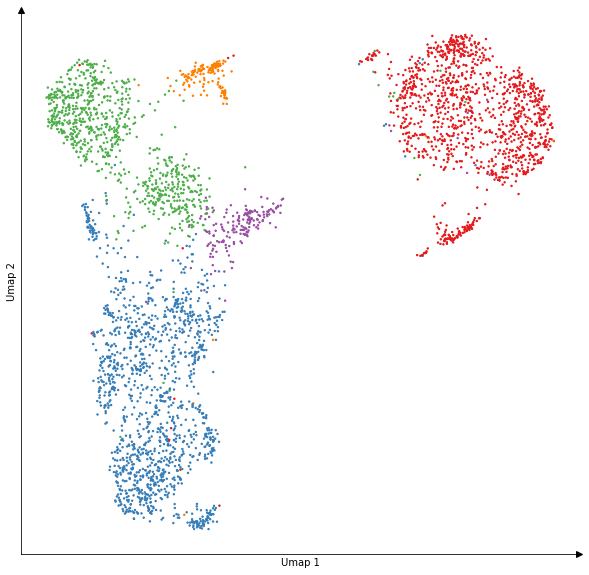

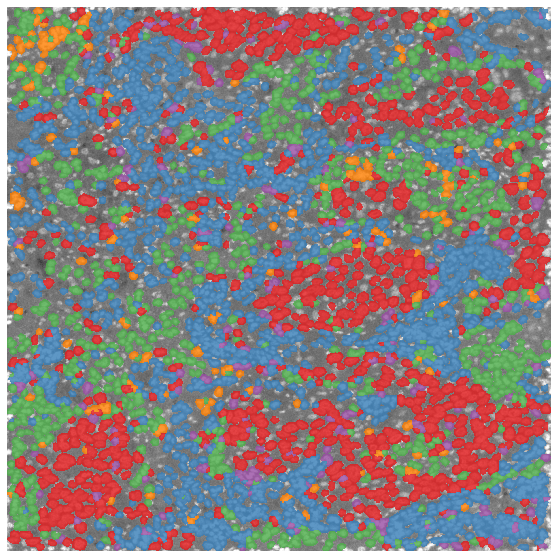

In [44]:
tol = 0.5

clusters = sch.fcluster(L, tol*d.max(), 'distance')
clusters_unique = np.unique(clusters)
n_clusters = len(np.unique(clusters))

# Change to row colors for clustermap
labels = df_per_label.index.to_list()
label2cluster = dict(zip(labels, clusters))
# Map cluster two min label in the cluster
result = defaultdict(int)
for k,v in zip(clusters, labels):
    result[k] = max(result[k], v)

vals = np.linspace(0, n_clusters/10, n_clusters)
my_cmap_row = plt.cm.Set1(vals)
my_cmap_dict = dict(zip(clusters_unique, my_cmap_row))
row_colors = pd.DataFrame(labels)[0].map(label2cluster).map(my_cmap_dict)

# Combined 
df_combined = df_exp.copy()
df_combined.Cluster = df_combined.Cluster.map(label2cluster.get)
df_combined.Cluster.astype(int)
df_combined = df_combined.groupby("Cluster").mean()
labels = df_combined.index.to_list()

row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)

create_HM(df_combined.T, path_cluster / 'parc_HM2.png', my_cmap_name, row_colors, scale_name)

clusters = np.array(list(map(label2cluster.get, parc_labels)))
cell2label = dict(zip(cell_id, clusters))

create_umap(embedding, clusters-1, path_cluster / 'parc_cell_mask_umap2.png', my_cmap_row)
create_clustered_cell(mask, cell2label, path_cluster / 'parc_cell_mask_cluster2.png', my_cmap_row)

# Loop through all dataset

In [20]:
def clustering_parc(X):
    parc1 = parc.PARC(X, jac_weighted_edges = False)
    parc1.run_PARC() 
    labels = parc1.labels
    
    graph = parc1.knngraph_full()
    embedding= parc1.run_umap_hnsw(X, graph, random_state = 1)
    return labels, embedding

Working on dataset ROI001_B1
Folder is already there
input data has shape 3095 (samples) x 20 (features)
knn struct was not available, so making one
commencing local pruning based on Euclidean distance metric at 3 s.dev above mean
commencing global pruning
commencing community detection
partition type MVP
list of cluster labels and populations 12 [(0, 565), (1, 420), (2, 352), (3, 290), (4, 269), (5, 253), (6, 220), (7, 222), (8, 168), (9, 138), (10, 131), (11, 67)]
time elapsed 3.0 seconds
a,b, spread, dist 1.5769434603935901 0.8950608781603765 1.0 0.1
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Working on dataset ROI005_B3
Folder is already there
input data has shape 3297 (samples) x 20 (features)
knn struct was not available

<ipython-input-16-4b68b8f676c6>:76: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(10.,10))


Working on dataset ROI008_D7
Folder is already there
input data has shape 3815 (samples) x 20 (features)
knn struct was not available, so making one
commencing local pruning based on Euclidean distance metric at 3 s.dev above mean
commencing global pruning
commencing community detection
partition type MVP
list of cluster labels and populations 14 [(0, 617), (1, 548), (2, 487), (3, 473), (4, 336), (5, 294), (6, 283), (7, 183), (8, 151), (9, 142), (10, 117), (11, 81), (12, 80), (13, 23)]
time elapsed 4.3 seconds
a,b, spread, dist 1.5769434603935901 0.8950608781603765 1.0 0.1
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Working on dataset ROI009_D9
Folder is already there
input data has shape 2685 (samples) x 20 (features)
knn stru

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\matrix.py:1205: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout(**tight_params)


Working on dataset ROI012_E1
Folder is already there
input data has shape 3643 (samples) x 20 (features)
knn struct was not available, so making one
commencing local pruning based on Euclidean distance metric at 3 s.dev above mean
commencing global pruning
commencing community detection
partition type MVP
list of cluster labels and populations 12 [(0, 540), (1, 520), (2, 420), (3, 363), (4, 343), (5, 301), (6, 276), (7, 242), (8, 235), (9, 219), (10, 97), (11, 87)]
time elapsed 3.8 seconds
a,b, spread, dist 1.5769434603935901 0.8950608781603765 1.0 0.1
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Working on dataset ROI015_B6
Folder is already there
input data has shape 1824 (samples) x 20 (features)
knn struct was not available,

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\matrix.py:1205: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout(**tight_params)


Working on dataset ROI020_E5
Folder is already there
input data has shape 1663 (samples) x 20 (features)
knn struct was not available, so making one
commencing local pruning based on Euclidean distance metric at 3 s.dev above mean
commencing global pruning
commencing community detection
partition type MVP
list of cluster labels and populations 11 [(0, 238), (1, 221), (2, 217), (3, 196), (4, 185), (5, 148), (6, 128), (7, 106), (8, 100), (9, 87), (10, 37)]
time elapsed 1.5 seconds
a,b, spread, dist 1.5769434603935901 0.8950608781603765 1.0 0.1
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Working on dataset ROI021_E7
Folder is already there
input data has shape 3500 (samples) x 20 (features)
knn struct was not available, so making 

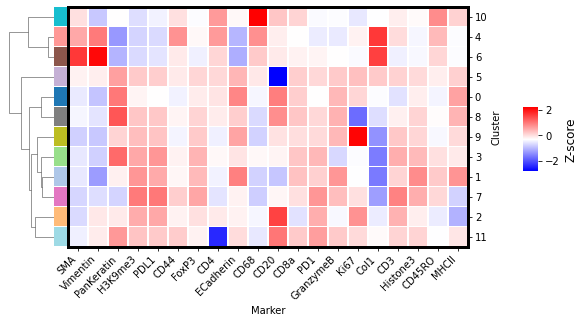

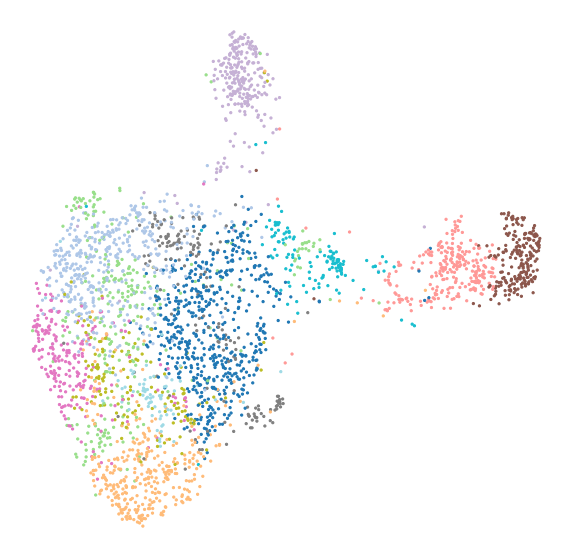

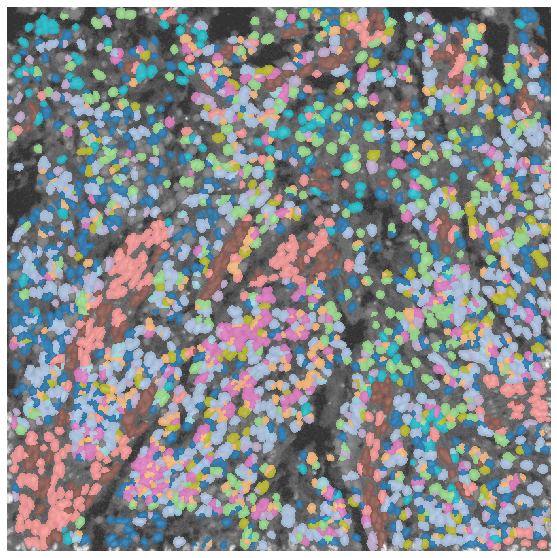

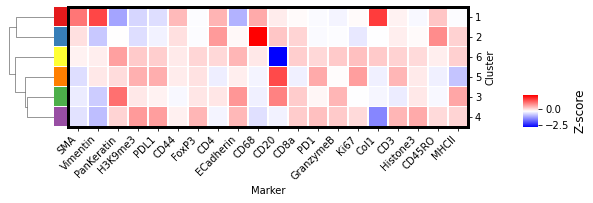

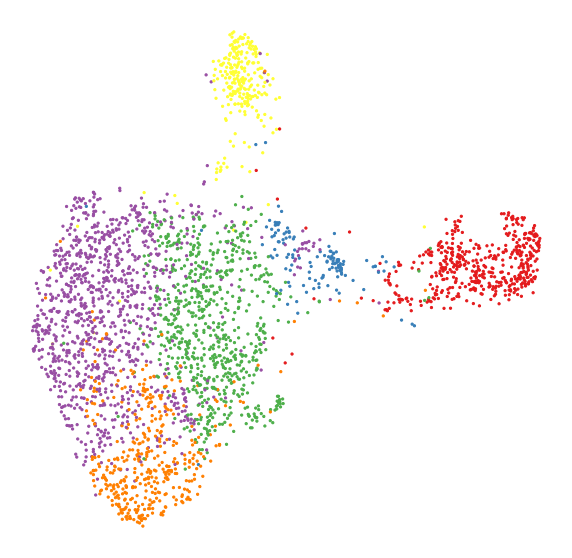

...

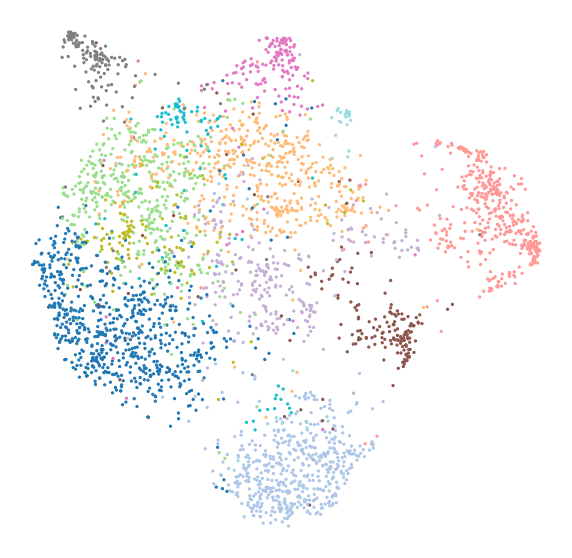

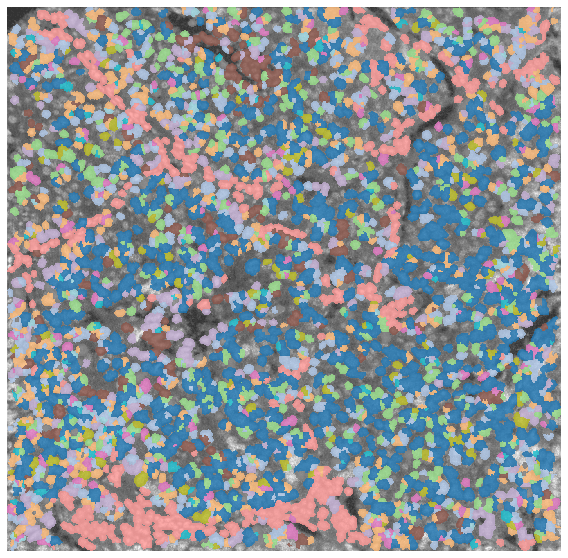

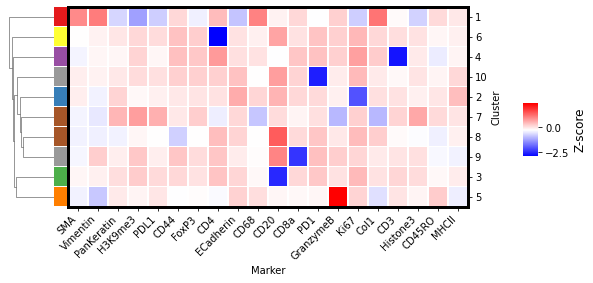

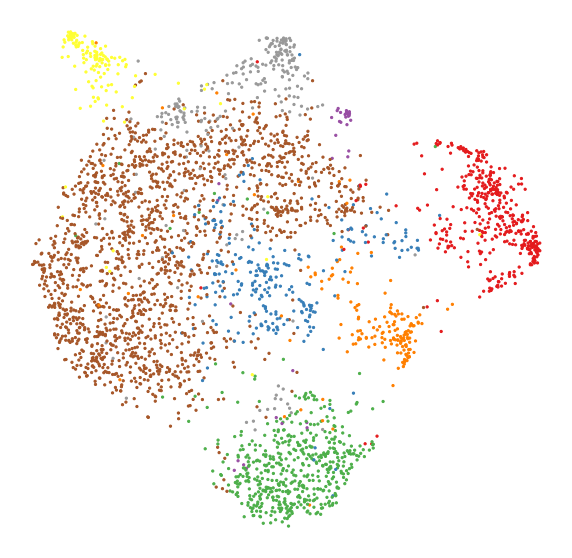

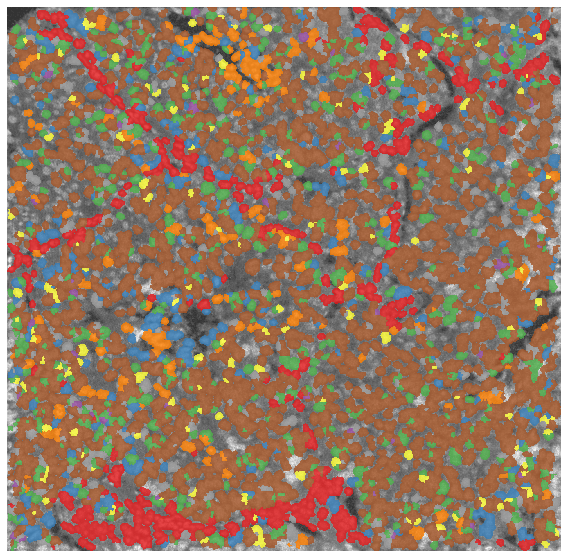

In [21]:
for dataset in datasets:
    print(f'Working on dataset {dataset}')
    # Check folder
    path_cluster = io.create_folder(dataset, data_cluster)
    
    # Read image and markers
    imgs, markers = io.read_img(dataset, data_ROI)
    marker2img = dict(zip(markers, imgs))
    mask = io.read_cell_mask(dataset, data_ROI)
    
    # Get mean intensity per cell
    df_exp = get_cell_expression_level(marker2img, mask)
    
   # Z score normalization by marker
    x_scaled = StandardScaler().fit_transform(np.log(df_exp+1))
    df_exp = pd.DataFrame(x_scaled, index = df_exp.index, columns=df_exp.columns)
    df_exp.head()

    # Per cell
    x_scaled = StandardScaler().fit_transform(df_exp.T).T
    df_exp = pd.DataFrame(x_scaled, index = df_exp.index, columns=df_exp.columns)
    df_exp.head()
    
    # Parc clustering 
    parc_labels, embedding = clustering_parc(df_exp.values)
    
    # Group per label
    df_exp['Cluster'] = parc_labels
    df_per_label = df_exp.groupby('Cluster').mean()
    
    d = sch.distance.pdist(df_per_label, metric='cosine')
    L = sch.linkage(d, method="average")

    # Get random colormap
    vals = np.linspace(0, 1, len(df_per_label))
    my_cmap_row = plt.cm.tab20(vals)

    # Change to row colors for clustermap
    labels = df_per_label.index.to_list()
    my_cmap_dict = dict(zip(labels, my_cmap_row))
    row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)

    create_HM(df_per_label, path_cluster / 'parc_HM.png', my_cmap_name, row_colors, scale_name, row_linkage=L)

    cell_id = df_exp.index.to_list()
    cell2label = dict(zip(cell_id, np.array(parc_labels)+1))

    create_umap(embedding, parc_labels, path_cluster / 'parc_cell_mask_umap.png', my_cmap_row)
    create_clustered_cell(mask, cell2label, path_cluster / 'parc_cell_mask_cluster.png' , my_cmap_row)
    
    # Combien cluster
    clusters = sch.fcluster(L, tol*d.max(), 'distance')
    clusters_unique = np.unique(clusters)
    n_clusters = len(np.unique(clusters))

    # Change to row colors for clustermap
    labels = df_per_label.index.to_list()
    label2cluster = dict(zip(labels, clusters))
    # Map cluster two min label in the cluster
    result = defaultdict(int)
    for k,v in zip(clusters, labels):
        result[k] = max(result[k], v)

    vals = np.linspace(0, n_clusters/10, n_clusters)
    my_cmap_row = plt.cm.Set1(vals)
    my_cmap_dict = dict(zip(clusters_unique, my_cmap_row))
    row_colors = pd.DataFrame(labels)[0].map(label2cluster).map(my_cmap_dict)

    # Combined 
    df_combined = df_exp.copy()
    df_combined.Cluster = df_combined.Cluster.map(label2cluster.get)
    df_combined.Cluster.astype(int)
    df_combined = df_combined.groupby("Cluster").mean()
    labels = df_combined.index.to_list()

    row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)

    create_HM(df_combined, path_cluster / 'parc_HM2.png', my_cmap_name, row_colors, scale_name)

    clusters = np.array(list(map(label2cluster.get, parc_labels)))
    cell2label = dict(zip(cell_id, clusters))

    create_umap(embedding, clusters-1, path_cluster / 'parc_cell_mask_umap2.png', my_cmap_row)
    create_clustered_cell(mask, cell2label, path_cluster / 'parc_cell_mask_cluster2.png', my_cmap_row)